In [24]:
import folium
import geopandas as gpd
import pandas as pd
from shapely import wkt

In [18]:
# zipcodes = gpd.read_file("c:\\Users\\izzye\\Downloads\\zipcodes\\tl_2023_us_zcta520.shp")

In [19]:
counties = gpd.read_file("..\\data\\Countys\\gz_2010_us_050_00_5m\\gz_2010_us_050_00_5m.shp")
counties.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [20]:
# states = gpd.read_file("c:\\Users\\izzye\\Downloads\\States\\gz_2010_us_040_00_5m\\gz_2010_us_040_00_5m.shp")

In [25]:
counties_csv = pd.read_csv("merged.csv")
counties_csv['geometry'] = counties_csv['geometry'].apply(wkt.loads)

In [30]:
counties_csv

,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry,Median Home Price Q4 2023,Monthly Payment Q4 2023,Monthly Payment Q4 2022
0,0500000US02261,AK,261,Valdez-Cordova,CA,34239.880,MULTIPOLYGON (((-147.483828196076 60.618636398...,NaN,NaN,NaN
1,0500000US02270,AK,270,Wade Hampton,CA,17081.433,"POLYGON ((-162.587753812495 63.2757266693285, ...",NaN,NaN,NaN
2,0500000US02275,AK,275,Wrangell,Cty&Bor,2541.483,MULTIPOLYGON (((-132.56988521290802 56.6335023...,NaN,NaN,NaN
3,0500000US02290,AK,290,Yukon-Koyukuk,CA,145504.789,"POLYGON ((-141.00246494156 65.83942100063071, ...",NaN,NaN,NaN
4,0500000US04003,AZ,3,Cochise,County,6165.690,"POLYGON ((-109.047612 32.426376999999995, -109...",220550.0,"$1,360","$1,240"
...,...,...,...,...,...,...,...,...,...,...
3216,0500000US50025,VT,25,Windham,County,785.305,"POLYGON ((-72.434466 43.230432, -72.4376559999...",279810.0,"$1,730","$1,450"
3217,0500000US50027,VT,27,Windsor,County,969.337,"POLYGON ((-72.43379571724721 43.232999131515, ...",279470.0,"$1,720","$1,450"
3218,0500000US51001,VA,1,Accomack,County,449.496,"MULTIPOLYGON (((-75.973607 37.835817, -75.9717...",198300.0,"$1,220","$1,070"
3219,0500000US51005,VA,5,Alleghany,County,445.457,"POLYGON ((-80.296138 37.691783, -80.294108 37....",132850.0,$820,$720


In [26]:
counties = gpd.GeoDataFrame(counties_csv, crs=4269, geometry='geometry')

<Axes: >

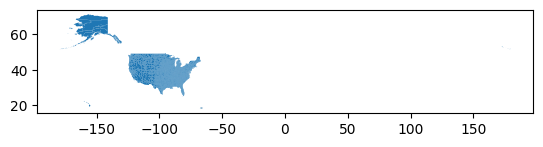

In [ ]:
counties.plot()

In [27]:
m = folium.Map(location=[38.8, -96.8], zoom_start=6)

In [ ]:
counties.set_crs(epsg=4326)

NameError: name 'counties' is not defined

In [28]:
folium.GeoJson(data=counties).add_to(m)

In [29]:
folium.GeoJson(
    counties,
    name="counties",
    fill_opacity=0.2,
    line_weight=0.1
).add_to(m)

In [31]:
folium.GeoJson(
    counties,
    name="Home Prices",
    tooltip=folium.GeoJsonTooltip(
        fields=['Median Home Price Q4 2023'],
        aliases=['Median Home Prices'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    ),
    show=True
).add_to(m)

In [32]:
m